# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.82'

In [2]:
pf.diad1_fit_config(model_name='Voigt', fit_peaks=1)

diad1_fit_config(model_name='Voigt', fit_peaks=1, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.2, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=100, HB_prom=20, x_range_baseline=75, y_range_baseline=100, dpi=200, x_range_residual=20, return_other_params=False)

In [3]:
help(pf.diad2_fit_config)

Help on class diad2_fit_config in module DiadFit.diads:

class diad2_fit_config(builtins.object)
 |  diad2_fit_config(model_name: str = 'PseudoVoigtModel', fit_peaks: int = 3, N_poly_bck_diad2: float = 1, lower_bck_diad2: Tuple[float, float] = (1300, 1360), upper_bck_diad2: Tuple[float, float] = (1440, 1470), fit_gauss: Optional[bool] = False, gauss_amp: Optional[float] = 1000, diad_sigma: float = 0.2, diad_sigma_min_allowance: float = 0.2, diad_sigma_max_allowance: float = 5, diad_prom: float = 100, HB_prom: float = 20, C13_prom: float = 10, x_range_baseline: float = 75, y_range_baseline: float = 100, plot_figure: bool = True, dpi: float = 200, x_range_residual: float = 20, return_other_params: bool = False) -> None
 |  
 |  Configuration class for fitting Diad 2
 |  
 |  This class stores configuration parameters for fitting Diad 2 and associated peaks.
 |  The class allows for easy customization of the fitting process.
 |  
 |  Attributes:
 |      model_name (str): Default 'PseudoVo

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, spectra_filetype, prefix, str_prefix, spectra_file_ext, meta_file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong')
batch='Strong' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

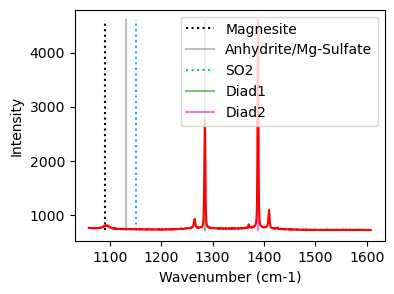

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220), upper_bck_diad1=(1330, 1350), fit_gauss=True, gauss_amp=389.97931848844496, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=2012.4019389914029, HB_prom=194.98965924422248, x_range_baseline=30, y_range_baseline=1000, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,HB1_Cent,HB1_Area,HB1_Sigma,Diad1_Combofit_Height,...,Diad1_fwhm,Diad1_Gauss_Cent,Diad1_Gauss_Area,Diad1_Gauss_Sigma,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad1_PDF_Model
0,1284.782189,1284.782339,0.002067,5982.664618,1.184251,0,1264.770311,883.052844,1.654391,2016.844611,...,2.368502,1277.806979,699.337252,23.869756,Flagged Warnings:,1.039244,1.067524,0.09295,0.001174,PseudoVoigtModel


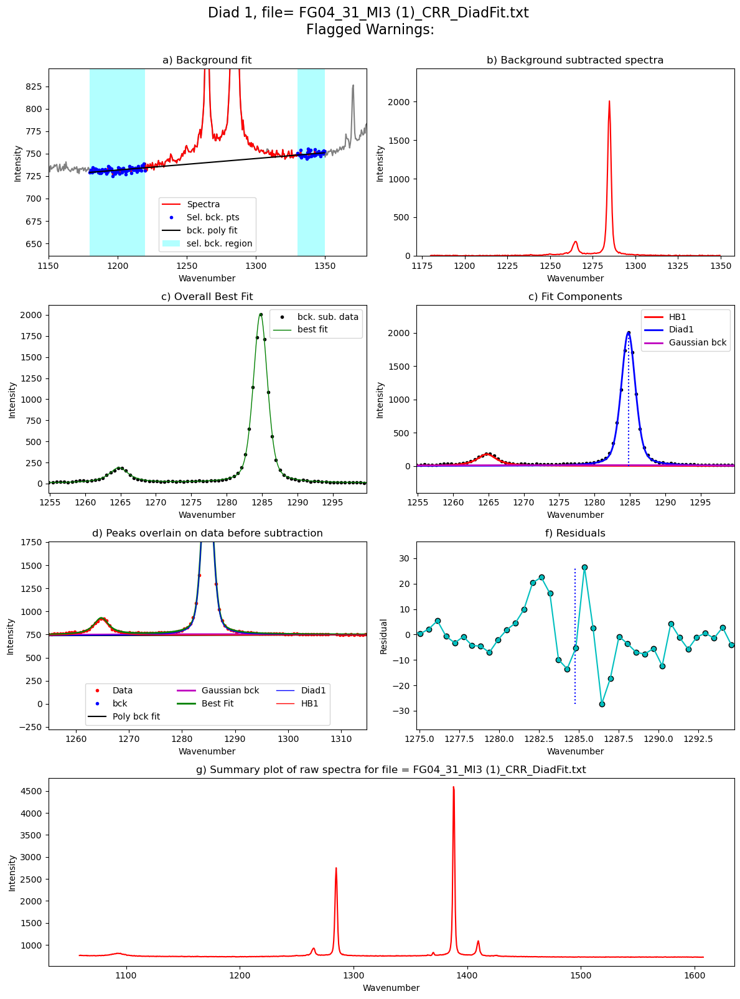

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=spectra_filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=1,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=3, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1340), upper_bck_diad2=(1440, 1470), fit_gauss=True, gauss_amp=725.2013981447026, diad_sigma=1, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=4046.9334876922258, HB_prom=362.6006990723513, x_range_baseline=30, y_range_baseline=1000, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False, C13_prom=65.32714727758116)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,C13_Cent,...,Diad2_fwhm,Diad2_Gauss_Cent,Diad2_Gauss_Area,Diad2_Gauss_Sigma,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad2_PDF_Model
0,1388.284861,1388.284811,0.001369,9768.420394,0.918253,0,1409.684413,1298.423776,1.309328,1370.209842,...,1.836506,1388.869255,643.840872,22.872435,Flagged Warnings:,1.027829,1.036486,0.051109,0.000449,PseudoVoigtModel


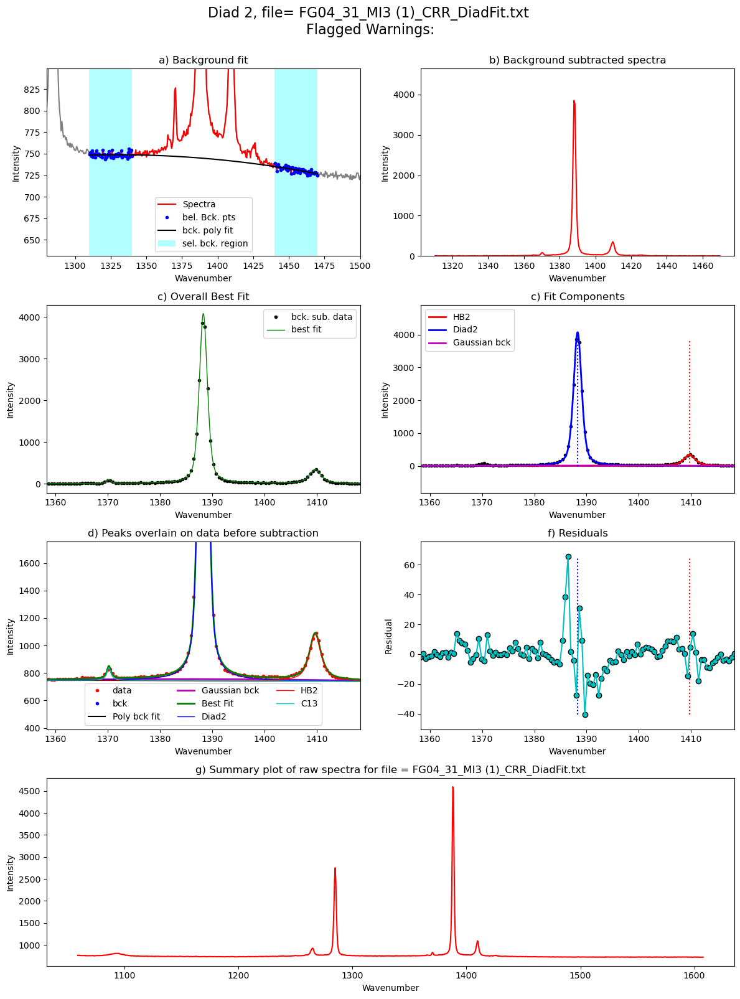

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/40 [00:00<?, ?it/s]

Processing file: FG04_31_MI3 (1)_CRR_DiadFit.txt


  2%|▎         | 1/40 [00:03<02:32,  3.91s/it]

Processing file: FG04_31_MI4 (1).txt


  5%|▌         | 2/40 [00:07<02:18,  3.63s/it]

Processing file: POC1.txt


  8%|▊         | 3/40 [00:11<02:15,  3.65s/it]

Processing file: POC10.txt


 10%|█         | 4/40 [00:14<02:09,  3.60s/it]

Processing file: POC11.txt


 12%|█▎        | 5/40 [00:18<02:13,  3.82s/it]

Processing file: POC12_CRR_DiadFit.txt


 15%|█▌        | 6/40 [00:21<02:03,  3.62s/it]

Processing file: POC13.txt


 18%|█▊        | 7/40 [00:25<01:59,  3.63s/it]

Processing file: POC14.txt


 20%|██        | 8/40 [00:29<02:02,  3.82s/it]

Processing file: POC15.txt


 22%|██▎       | 9/40 [00:32<01:47,  3.48s/it]

Processing file: POC16.txt


 25%|██▌       | 10/40 [00:35<01:41,  3.38s/it]

Processing file: POC17.txt


c:\users\penny\box\berkeley_new\diadfit_outer\src\DiadFit\diads.py:3043: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))
 28%|██▊       | 11/40 [00:38<01:31,  3.16s/it]

Processing file: POC18.txt
refit attempt 1


 30%|███       | 12/40 [00:41<01:28,  3.15s/it]

Processing file: POC19.txt


 32%|███▎      | 13/40 [00:44<01:22,  3.06s/it]

Processing file: POC2.txt


 35%|███▌      | 14/40 [00:48<01:24,  3.24s/it]

Processing file: POC20.txt


 38%|███▊      | 15/40 [00:51<01:19,  3.17s/it]

Processing file: POC21.txt


 40%|████      | 16/40 [00:53<01:14,  3.09s/it]

Processing file: POC22_CRR_DiadFit.txt


 42%|████▎     | 17/40 [00:56<01:10,  3.07s/it]

Processing file: POC23.txt


 45%|████▌     | 18/40 [00:59<01:06,  3.01s/it]

Processing file: POC24.txt


 48%|████▊     | 19/40 [01:03<01:04,  3.07s/it]

Processing file: POC25_CRR_DiadFit.txt


 50%|█████     | 20/40 [01:06<01:02,  3.13s/it]

Processing file: POC26.txt


 52%|█████▎    | 21/40 [01:09<00:58,  3.06s/it]

Processing file: POC27_CRR_DiadFit.txt


 55%|█████▌    | 22/40 [01:12<00:57,  3.19s/it]

Processing file: POC28.txt


 57%|█████▊    | 23/40 [01:15<00:52,  3.08s/it]

Processing file: POC29.txt


 60%|██████    | 24/40 [01:19<00:52,  3.30s/it]

Processing file: POC3.txt


 62%|██████▎   | 25/40 [01:22<00:49,  3.29s/it]

Processing file: POC30.txt


 65%|██████▌   | 26/40 [01:25<00:44,  3.20s/it]

Processing file: POC31.txt


 68%|██████▊   | 27/40 [01:35<01:06,  5.08s/it]

Processing file: POC32.txt


 70%|███████   | 28/40 [01:38<00:55,  4.61s/it]

Processing file: POC33.txt


 72%|███████▎  | 29/40 [01:42<00:48,  4.44s/it]

Processing file: POC34.txt


 75%|███████▌  | 30/40 [01:49<00:51,  5.14s/it]

Processing file: POC35.txt


 78%|███████▊  | 31/40 [01:53<00:43,  4.87s/it]

Processing file: POC36_CRR_DiadFit.txt


 80%|████████  | 32/40 [01:57<00:36,  4.58s/it]

Processing file: POC37.txt


 82%|████████▎ | 33/40 [02:00<00:27,  3.98s/it]

Processing file: POC38_CRR_DiadFit.txt


 85%|████████▌ | 34/40 [02:04<00:24,  4.05s/it]

Processing file: POC4_CRR_DiadFit.txt


 88%|████████▊ | 35/40 [02:06<00:18,  3.63s/it]

Processing file: POC5.txt


 90%|█████████ | 36/40 [02:09<00:13,  3.29s/it]

Processing file: POC6_CRR_DiadFit.txt


 92%|█████████▎| 37/40 [02:12<00:09,  3.08s/it]

Processing file: POC7_CRR_DiadFit.txt


 95%|█████████▌| 38/40 [02:14<00:05,  2.95s/it]

Processing file: POC8.txt


 98%|█████████▊| 39/40 [02:17<00:02,  2.96s/it]

Processing file: POC9.txt


100%|██████████| 40/40 [02:21<00:00,  3.53s/it]


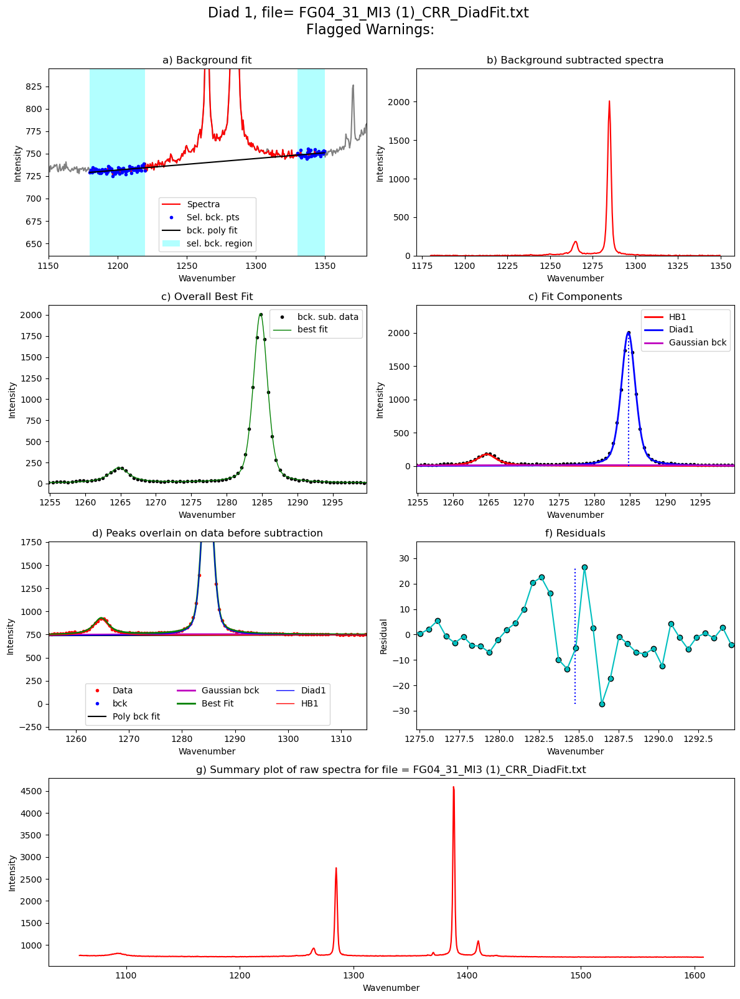

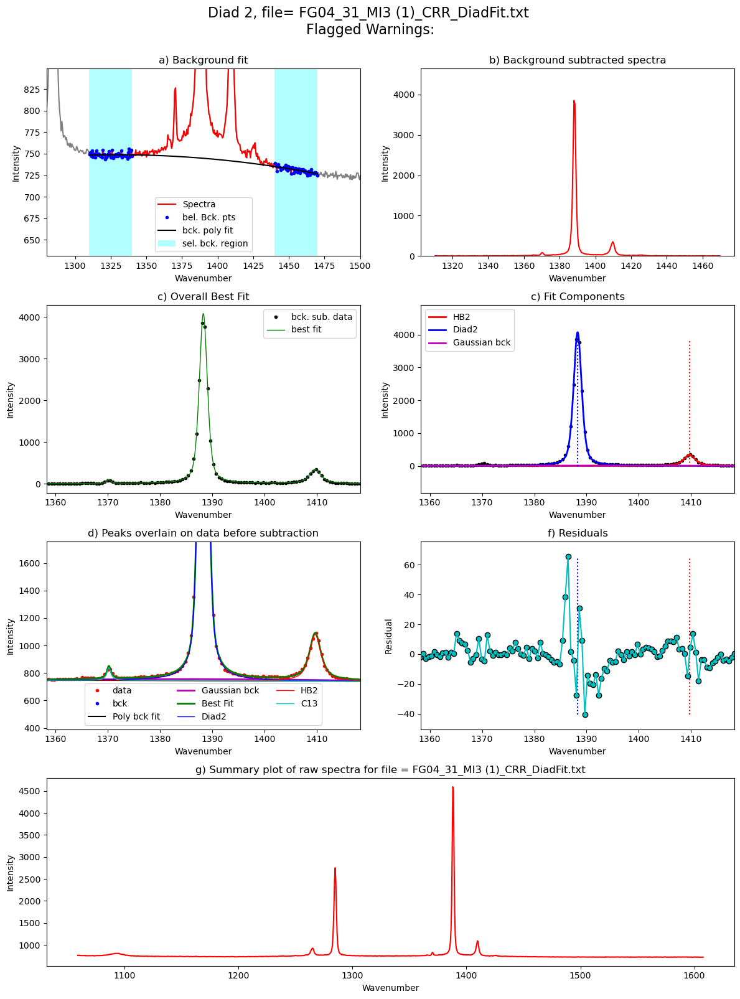

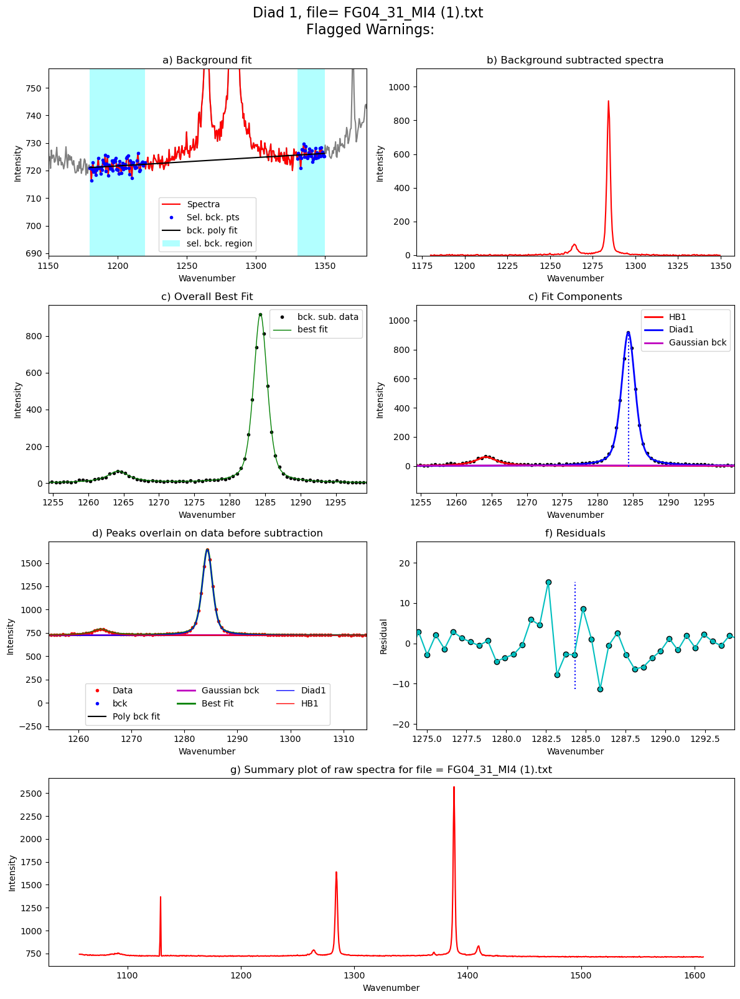

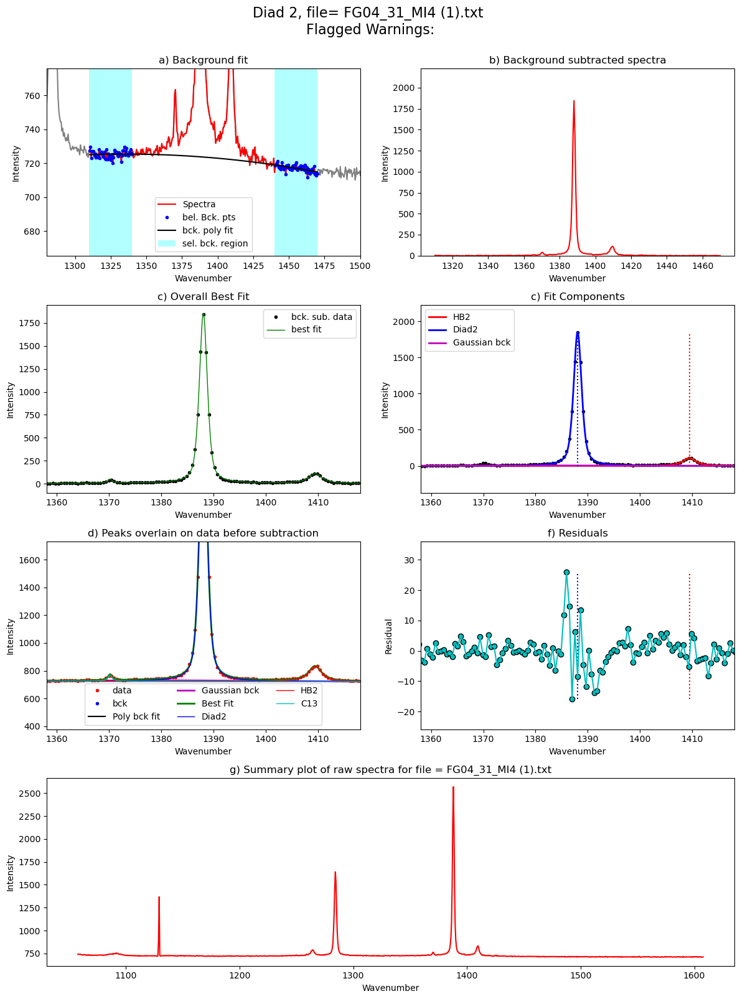

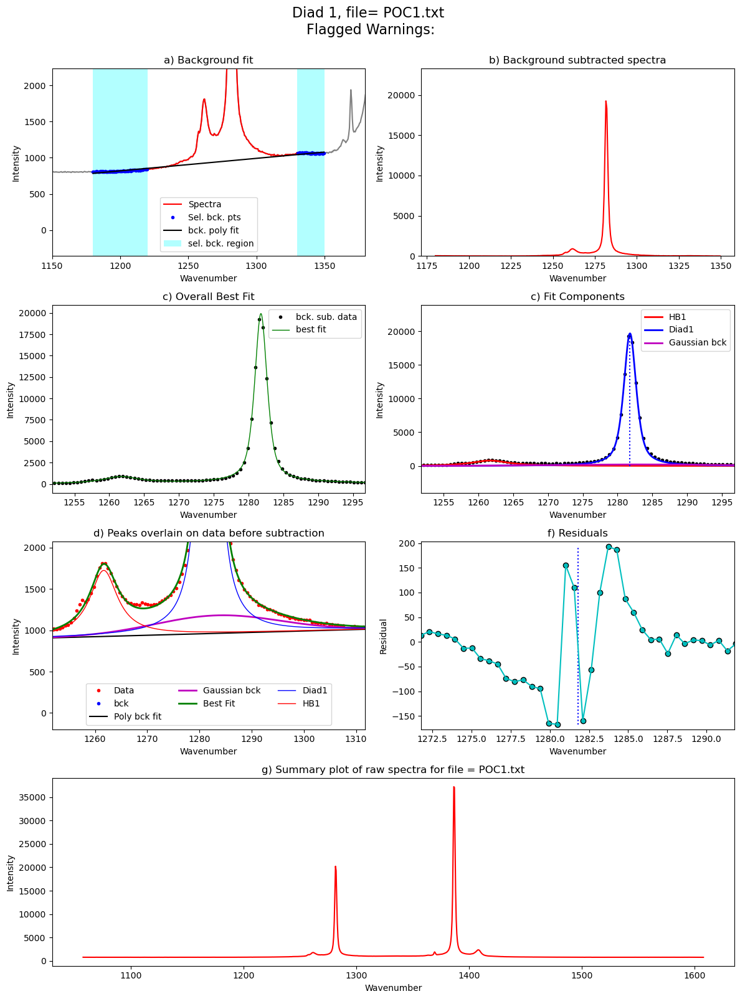

...

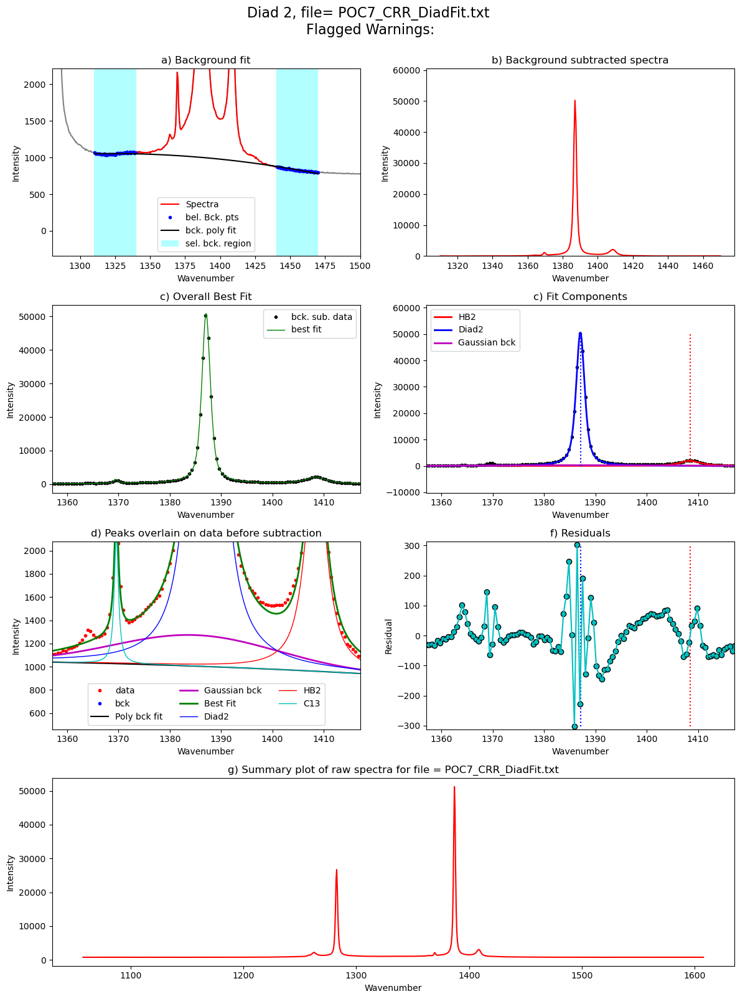

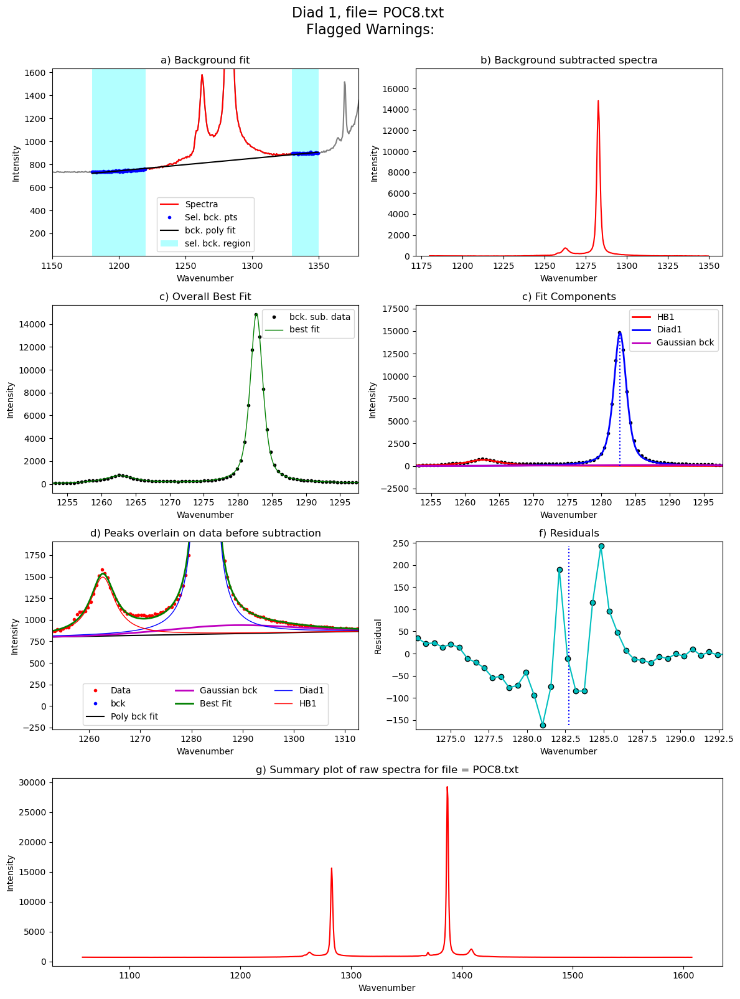

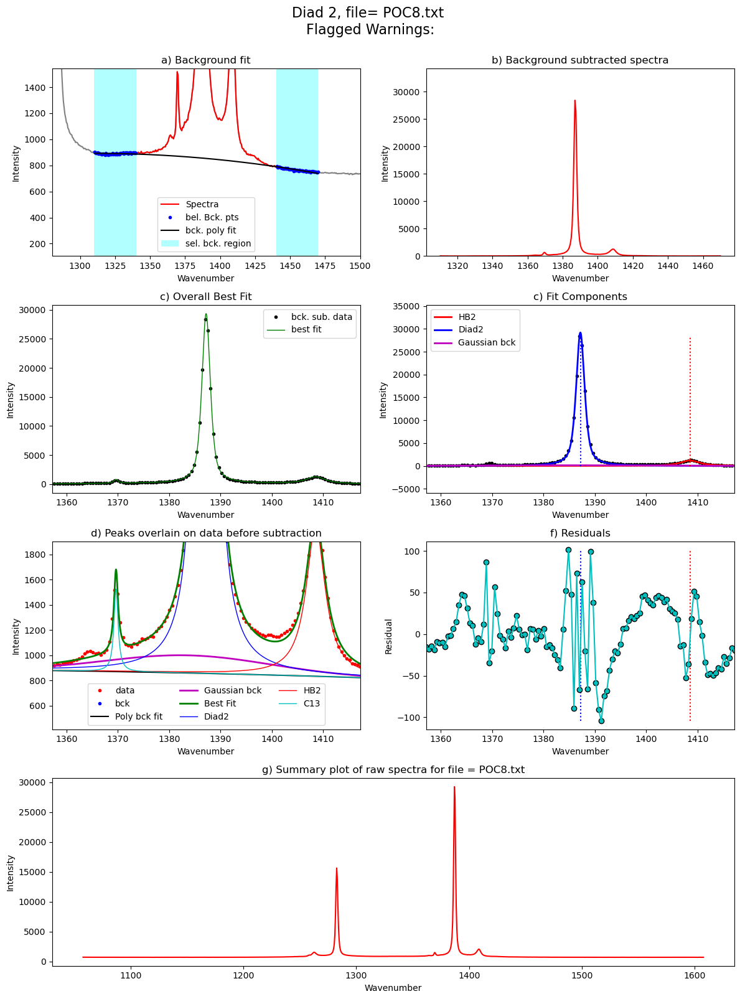

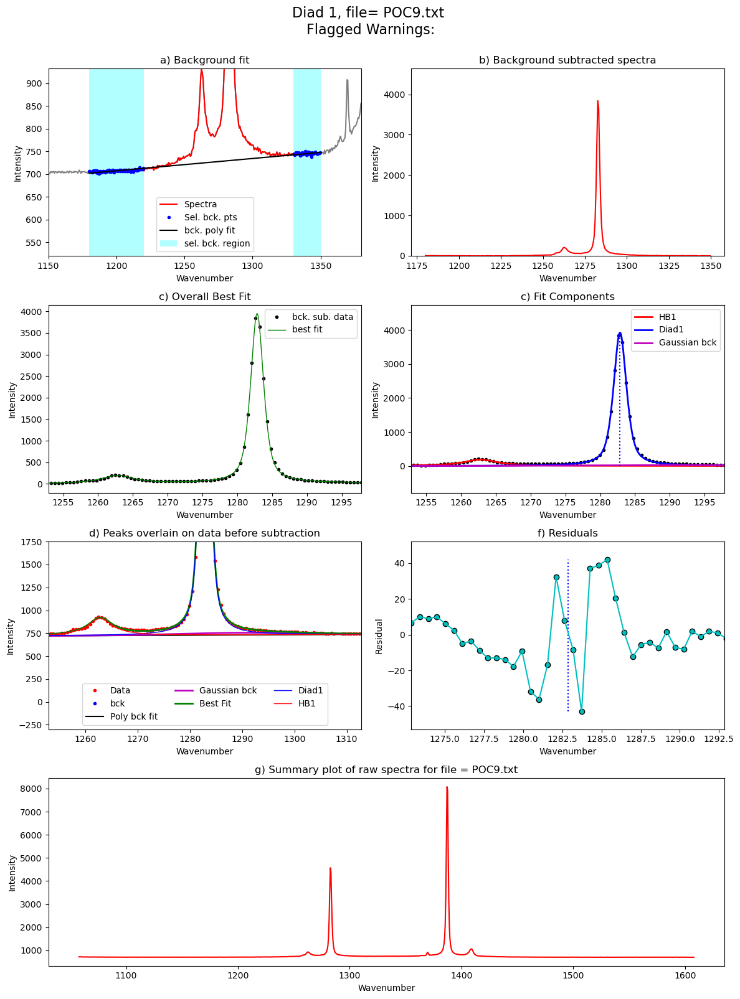

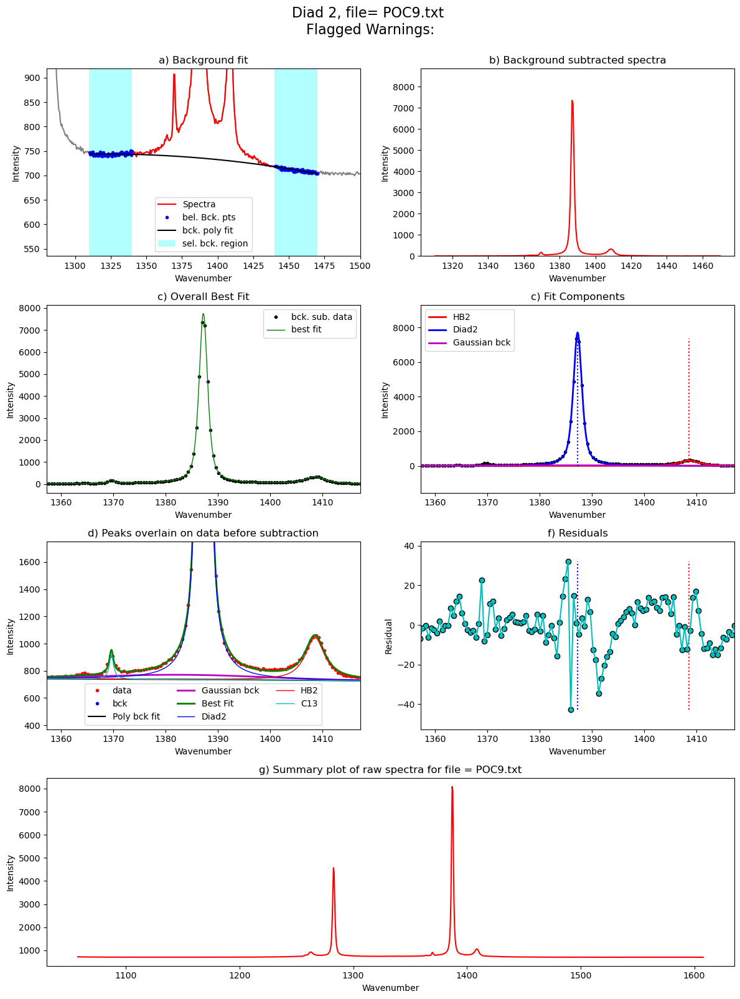

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=spectra_filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=spectra_filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad1_PDF_Model,Diad2_PDF_Model
0,FG04_31_MI3 (1)_CRR_DiadFit,103.502472,0.002479,1284.782189,0.002067,2016.844611,1284.782339,5982.664618,1.184251,3.979666,...,1.039244,1.067524,0.092950,0.001174,1.027829,1.036486,0.051109,0.000449,PseudoVoigtModel,PseudoVoigtModel
1,FG04_31_MI4 (1),103.709921,0.002716,1284.338717,0.002301,921.578580,1284.338767,2757.717719,1.149527,1.973458,...,1.000000,1.057359,0.000000,0.002495,1.007407,1.006667,0.013552,0.000986,PseudoVoigtModel,PseudoVoigtModel
2,POC1,104.947850,0.001623,1281.782853,0.001405,19925.591779,1281.782803,59223.825265,1.072208,22.259595,...,1.065916,1.079096,0.141352,0.000108,1.038017,1.036952,0.078457,0.000054,PseudoVoigtModel,PseudoVoigtModel
3,POC10,104.306739,0.001693,1283.013429,0.001510,3840.009480,1283.013379,11741.225881,1.134571,5.057416,...,1.008929,1.032051,0.020260,0.000591,1.042179,1.027295,0.082247,0.000255,PseudoVoigtModel,PseudoVoigtModel
4,POC11,104.250666,0.001991,1283.138753,0.001831,3180.585088,1283.138803,9823.987216,1.167960,4.487365,...,1.024818,1.050847,0.057972,0.000734,1.042857,1.036432,0.082636,0.000298,PseudoVoigtModel,PseudoVoigtModel
5,POC12_CRR_DiadFit,104.163684,0.001728,1283.321213,0.001539,4283.682570,1283.321263,13368.448742,1.188387,5.068715,...,1.056851,1.060797,0.135123,0.000555,1.007018,1.009950,0.013583,0.000222,PseudoVoigtModel,PseudoVoigtModel
6,POC13,104.134046,0.001671,1283.384610,0.001466,4011.284262,1283.384660,12619.856036,1.197456,4.509645,...,1.028571,1.040165,0.068426,0.000597,1.007005,1.001236,0.013592,0.000235,PseudoVoigtModel,PseudoVoigtModel
7,POC14,104.108371,0.001674,1283.442762,0.001422,3719.983549,1283.442812,11830.425690,1.211482,4.361908,...,1.025388,1.032454,0.061514,0.000651,1.017668,1.015000,0.034166,0.000251,PseudoVoigtModel,PseudoVoigtModel
8,POC15,104.068362,0.001568,1283.528756,0.001306,3486.272395,1283.528806,11077.108501,1.212768,3.822150,...,1.005563,1.012072,0.013494,0.000696,1.021164,1.015056,0.040943,0.000270,PseudoVoigtModel,PseudoVoigtModel
9,POC16,104.026014,0.001623,1283.620048,0.001325,3195.985921,1283.620098,10144.318897,1.227720,3.585005,...,1.012414,1.031219,0.030481,0.000768,1.019332,1.020075,0.037489,0.000294,PseudoVoigtModel,PseudoVoigtModel


### This plays a sound - if you have a tendency  to procrastinate while notebooks are running

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done! - Now fit other groups",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()